
## INSTRUCTIONS

- This homework is a notebook. Download and work on it on your local machine or work on it in Colab.

- This homework should be submitted in pairs.

- Ensure you and your partner together have submitted the homework only once. Multiple submissions of the same work will be penalised and will cost you 2 points.

- Please restart the kernel and run the entire notebook again before you submit.

- Running cells out of order is a common pitfall in Jupyter Notebooks. To make sure your code works restart the kernel and run the whole notebook again before you submit.

- To submit the homework, either one of you upload the working notebook on edStem and click the submit button on the bottom right corner.

- Submit the homework well before the given deadline. Submissions after the deadline will not be graded.

- We have tried to include all the libraries you may need to do the assignment in the imports statement at the top of this notebook. We strongly suggest that you use those and not others as we may not be familiar with them.

- Comment your code well. This would help the graders in case there is any issue with the notebook while running. It is important to remember that the graders will not troubleshoot your code.

- Please use .head() when viewing data. Do not submit a notebook that is **excessively long**.

- In questions that require code to answer, such as "calculate the $R^2$", do not just output the value from a cell. Write a `print()` function that includes a reference to the calculated value, **not hardcoded**. For example:
```
print(f'The R^2 is {R:.4f}')
```
- Your plots should include clear labels for the $x$ and $y$ axes as well as a descriptive title ("MSE plot" is not a descriptive title; "95 % confidence interval of coefficients of polynomial degree 5" is).

- **Ensure you make appropriate plots for all the questions it is applicable to, regardless of it being explicitly asked for.**

<hr style="height:2pt">

## **Names of the people who worked on this homework**
#### / Wang Hesong/ Chen Taiyi/ Mao Yuchen/ Yu Lufei/ Li Yuepeng/ Zhong Yixiao

## **Setup Notebook**

In [13]:
import requests
import re
import os
import zipfile
import collections
import numpy as np
import pandas as pd
import urllib.request
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from collections import defaultdict
%matplotlib inline
from IPython.core.display import HTML

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.python.keras import backend as K
from tensorflow.keras.models import Model
from collections import defaultdict

from sklearn.model_selection import train_test_split

**Verify Setup**

In [14]:
# Enable/Disable Eager Execution
# Reference: https://www.tensorflow.org/guide/eager
# TensorFlow's eager execution is an imperative programming environment that evaluates operations immediately,
# without building graphs

#tf.compat.v1.disable_eager_execution()
#tf.compat.v1.enable_eager_execution()

print("tensorflow version", tf.__version__)
print("keras version", tf.keras.__version__)
print("Eager Execution Enabled:", tf.executing_eagerly())

# # Get the number of replicas
# strategy = tf.distribute.MirroredStrategy()
# print("Number of replicas:", strategy.num_replicas_in_sync)

devices = tf.config.experimental.get_visible_devices()
print("Devices:", devices)
print(tf.config.experimental.list_logical_devices('GPU'))

print("GPU Available: ", tf.config.list_physical_devices('GPU'))
print("All Physical Devices", tf.config.list_physical_devices())

# Better performance with the tf.data API
# Reference: https://www.tensorflow.org/guide/data_performance
AUTOTUNE = tf.data.experimental.AUTOTUNE

tensorflow version 2.10.0
keras version 2.10.0
Eager Execution Enabled: True
Devices: [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
[LogicalDevice(name='/device:GPU:0', device_type='GPU')]
GPU Available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
All Physical Devices [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## **PART 1 [32 points]: Language Modeling using n-grams**
<br />    

You have been tasked with developing a language model for a disaster response station. The model needs to complete messages that, for some reason, arrive incomplete. Given the delicate situation, you will have to be extra careful. Each word in the sentence conveys a lot of information, and improper handling of the data could cause someone to come in harm's way.

Your language model will be based on bigrams. You need to develop your own sub-word tokenization to analyze disaster messages from multiple natural disasters. All the sentences are translated into English.

### **PART 1: Questions**
<br />

#### **1.1 [5 points] Preprocess the dataset**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**1.1.1** Read in the dataset `disaster_response_messages_training.csv` and select only the column "message" and display the head of the DataFrame.
<br /><br />

**1.1.2** Define a function `clean_data` that takes the data frame as input, converts the characters to lower case and removes any non-alphanumeric characters,  adds the start token `<s>` and the end token `</s>` to every sentence (row) in the data frame and returns the processed data frame.
<br />
**Sample Input:** "Is there a dog^ on the road?" <br />
**Sample Output:** "\<s> is there a dog on the road \</s>"
<br /><br />


**1.1.3** Split the dataset into train and test sets. The proportion should be 0.95 and 0.05, respectively. You will create the language model based on the training set and validate your results on the test set.
<br /><br />
</details>

    
#### **1.2 [8 points] Tokenize and Count**
<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>

In this section, you will build a tokenizer on which your LM will be based. The tokenization functions must divide the text into tokens, count their frequency and return a dictionary with a mapping of token to number.
<br />


**1.2** Create a tokenization function ('tokenizer') based on sub-words. You have to define a set of common sub-words in the English language, for example, the subtokens "_ing_" and "_n't_". Here again, do not limit the vocabulary size.

In this example, the sentence "_It is raining outside_" would be tokenized as [_It_, _is_, _rain_, _ing_, _outside_ ].


**Note:** Use words only from the train data to create the vocabulary. Add an additional `<UNK>` token to handle new words found in the test set. Remove the empty character token, as it provides no information
<br /><br />
</details>
    
#### **1.3 [6 points] Constructing Bigrams**
<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>

**1.3.1** Using the tokenizer functions you created, split each sentence into tokens in their numerical representation.
<br /><br />

**1.3.2** Count the occurrences of each bigram (w1,w2) in the training dataset and divide them by the total occurrences of the first word (w1). This will give you the probability of each bigram.
<br /><br />
</details>
    
#### **1.4 [8 points] Predicting the next words**
<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>

**1.4.1** The task is to complete the sentences using the language model. From a full sentence, remove the last five tokens and predict them using your language model.

For example in the sentence: "I will go out on a vacation, now that my semester ended."

The first part will be "I will go out on a vacation,"

The last part will be "now that my semeter ended"

Your aim is to predict the last part by giving your model the first part of the sentence.

For 6 sentences from the test set, predict the next word. Compare your results with the original sentences. Are the sentences predicted by the language model accurate? Why not?

Note: If there is an <UNK> word and you need to predict the next word, predict the next word based on unigram probabilities (calculate this by using word count from Section 1.2).


In an n-gram language model, only the last  𝑛−1  words are used to make a prediction.
<br /><br />

**1.4.2** Repeat the same exercise, but this time, the next token will be sampled from a distribution given by the bigram frequency. Compare and comment on the results.


**Hint:**
Bigram frequencies refer to the likelihood of a word appearing after another in a text. In a model returning two bigrams with frequencies 0.7 and 0.3, a deterministic prediction will only predict the first bigram. Sampling from a distribution is simply considering all possible bigrams returned by the model 'weighted' by their associated frequency. This will enable the model to predict the second bigram with a probability of 0.3. In this way, we can still predict infrequent tokens.

<br /><br />
</details>
    

#### **1.5 [5 points] Evaluate the Language Models**
<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>

    
**1.5.1**

**1.5.1.1:** Use smoothing for your n-gram model to account for any token that is present in the test set and not in the training set.
</br>
You may recall the additive smoothing formula from Session 1 :
</br>
$$P(w) =  \frac{n_w (d)+ α}{|W|+ α |V|}$$
</br>

**1.5.1.2:** Define a function to compute perplexity. Use this function to compute the perplexity of each sentence of the test set.

**Note:** Use the bigram probabilities for this. Here $n_w$ is the number of bigrams.

**1.5.2** Compute the perplexities using the probabilities you calculated above.

Print 5 sentences that associate with perplexities below the 10th percentile and 5 sentences that associates with perplexities above the 90th percentile. Do you see any pattern? Explain.

**1.5.3** Report the distribution statistics: mean, median, mode, and standard deviation. Comment on your results.

**Note:** Use the bigram probabilities for this. N (from the perplexity formula) - Number of words in the sentence.
<br /><br />
</details>
</div>

---

### **PART 1: Solutions**

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">
    
#### **1.1 [5 points] Preprocess the dataset**


</div>


**1.1.1** - Read in the dataset `disaster_response_messages_training.csv`. Select only the column "message" and display the head of the DataFrame.
<br />

If you want to download the file, you can get it from [here](https://drive.google.com/uc?id=1JRWRywWDZRdxTG1n9H9xTHXNapNdrTOJ&export=download).

In [15]:
file_path = "https://drive.google.com/uc?id=12VrtStJx0a3AiHjwnaiPLWH6cGHKz6Uo&export=download"
data=pd.read_csv(file_path,usecols=['message'])
data.head()

,message
0,Weather update - a cold front from Cuba that c...
1,Is the Hurricane over or is it not over
2,"says: west side of Haiti, rest of the country ..."
3,Information about the National Palace-
4,Storm at sacred heart of jesus



<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">
    
**1.1.2** - Define a function `clean_data` that takes the data frame as input, converts the characters to lower case and removes any non-alphanumeric,  adds the start token `<s>` and the end token `</s>` to every sentence (row) in the data frame and returns the processed data frame.
<br />
**Sample Input:** "Is there a dog^ on the road?" <br />
**Sample Output:** "\<s> is there a dog on the road \</s>"
    
</div>

In [16]:
def clean_data(df):

    # Your code here
    df['message'] = df['message'].str.lower()
    df['message'] = df['message'].apply(lambda x: re.sub(r'[^a-zA-Z0-9\s]', '', x))
    df['message'] = df['message'].apply(lambda x: '<s> ' + x + ' </s>')

    return df

df = clean_data(data)
df.head()

,message
0,<s> weather update a cold front from cuba tha...
1,<s> is the hurricane over or is it not over </s>
2,<s> says west side of haiti rest of the countr...
3,<s> information about the national palace </s>
4,<s> storm at sacred heart of jesus </s>


In [17]:
df.head()

,message
0,<s> weather update a cold front from cuba tha...
1,<s> is the hurricane over or is it not over </s>
2,<s> says west side of haiti rest of the countr...
3,<s> information about the national palace </s>
4,<s> storm at sacred heart of jesus </s>


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**1.1.3** - Split the dataset into train and test sets. The proportion should be 0.95 and 0.05, respectively. You will create the language model based on the training set and validate your results on the test set.
</div>

In [18]:
# Your code here

train_index, test_index = train_test_split(df.index, train_size=0.95,random_state=0)

df_train = df.loc[train_index]
df_test = df.loc[test_index]
print(len(df))

21046


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **1.2 [8 points] Tokenize and Count**

    
</div>



In this section, you will build a tokenizer on which your LM will be based. The tokenization functions must divide the text into tokens, count their frequency and return a dictionary with a mapping of token to number.
<br />


Create a tokenization function ('tokenizer') based on sub-words. You have to define a set of common sub-words in the English language, for example, the subtokens "_ing_" and "_n't_". Here again, do not limit the vocabulary size.

In this example, the sentence "_It is raining outside_" would be tokenized as [_It_, _is_, _rain_, _ing_, _outside_ ].

    
**Note:** Use words only from the train data to create the vocabulary. Add an additional `<UNK>` to handle new words found in the test set. Remove the empty character token, as it provides no information.
<br /><br />


In [19]:
subtokens = ['ed', 'ing', 'n\'t', 'tion']
counts = dict.fromkeys(subtokens,0)
print(counts)

{'ed': 0, 'ing': 0, "n't": 0, 'tion': 0}


In [20]:
# Your code here
word_count = dict()
word_index = dict()
# tokenizer = keras.preprocessing.text.Tokenizer(oov_token="<UNK>")

# Helper function to split the word with its subtoken
def process_word(word):
  for subtoken in subtokens:
    if word.endswith(subtoken):
      return word[:-len(subtoken)] + ' ' + subtoken
  return word

def tokenizer(df):
  # Split the word with its subtoken
  df['message'] = df['message'].apply(lambda x: ' '.join(process_word(word) for word in x.split()))
  df['message'] = df['message'].str.split()

  # Convert the dataframe to numerical representation
  text_tokenizer = keras.preprocessing.text.Tokenizer(oov_token="<UNK>")
  text_tokenizer.fit_on_texts(df['message'])
  df['message'] = text_tokenizer.texts_to_sequences(df['message'])
  # word_index = tokenizer.word_index

  # Get the frequency
  all_words = [str(word) for words in df['message'] for word in words]
  words_count = collections.Counter(all_words)
  global word_count
  word_count = dict(words_count)

  return text_tokenizer.word_index

# word_index = tokenize(df_train)
# print(len(word_count))
# df_train.head()

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **1.3 [6 points] Constructing Bigrams**
    
</div>

**1.3.1** - Using the tokenizer function you created, split each sentence into tokens in their numerical representation.

In [21]:
# Your code here
word_index = tokenizer(df_train)
print(len(word_count))

32125


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**1.3.2** - For the tokenizer, count the occurrences of each bigram (w1,w2) in the training dataset and divide them by the total occurrences of the first word (w1). This will give you the probability of each bigram.
    
</div>

In [22]:
# Your code here
# lexicon = dict()
# for x in range(1):
#   word = 11
#   word_dict = dict()
#   follow_list = []
#   for text in df_train['message']:
#     # print(type(text[1]))
#     if word in text:
#       indices = [index for index, value in enumerate(text) if value == word]
#       print(f"word is {word}")
#       print(indices)
#       for i in indices:
#         follow_list.append(text[i+1])
#   for follower in follow_list:
#     if follower not in word_dict:
#       prob = follow_list.count(follower) / word_count.get(str(word))
#       word_dict.update({follower:prob})
#   lexicon.update({word:word_dict})

# print(lexicon)

lexicon = dict()
for word in word_count.keys():
  word = int(word)
  word_dict = dict()
  follow_list = []
  for text in df_train['message']:
    if word in text:
      indices = [index for index, value in enumerate(text) if value == word]
      #print(f"word is {word}")
      #print(indices)
      for i in indices:
        if i < len(text)-1:
          follow_list.append(text[i+1])
  for follower in follow_list:
    if follower not in word_dict:
      prob = follow_list.count(follower) / word_count.get(str(word))
      word_dict.update({follower:prob})
  lexicon.update({word:word_dict})

In [23]:
# Your code here
# lexicon = dict()
# for word in word_count.keys():
#   word_dict = dict()
#   follow_list = []
#   for text in df_train['message']:
#     if word in text:
#       indices = [index for index, value in enumerate(text) if value == word]
#       print(f"word is {word}")
#       print(indices)
#       for i in indices:
#         follow_list.append(text[i+1])
#   for follower in follow_list:
#     if follower not in word_dict:
#       prob = follow_list.count(follower) / word_count.get(word)
#       word_dict.update({follower:prob})
#   lexicon.update({word:word_dict})

print(len(lexicon))
print(lexicon.get(11))
print(type(word_count.keys()))
print(word_count.get(11))
print(word_count.values())
df_train.head()


32125
{225: 0.005110274341043572, 9778: 0.00026896180742334586, 379: 0.01048951048951049, 4132: 0.00013448090371167293, 3857: 0.00013448090371167293, 9783: 0.00026896180742334586, 5894: 0.00013448090371167293, 508: 0.00013448090371167293, 13823: 0.00013448090371167293, 1128: 0.00013448090371167293, 2338: 0.00026896180742334586, 549: 0.00026896180742334586, 6720: 0.00026896180742334586, 7951: 0.00026896180742334586, 653: 0.002151694459386767, 268: 0.0034965034965034965, 197: 0.0018827326519634212, 5295: 0.00013448090371167293, 1319: 0.00013448090371167293, 468: 0.0037654653039268424, 13847: 0.00013448090371167293, 1066: 0.0009413663259817106, 1875: 0.0012103281334050564, 1181: 0.0010758472296933835, 1141: 0.0008068854222700376, 564: 0.01048951048951049, 337: 0.005782678859601937, 1454: 0.0006724045185583647, 1451: 0.00228617536309844, 398: 0.0053792361484669175, 586: 0.0013448090371167294, 823: 0.0006724045185583647, 1638: 0.0004034427111350188, 2625: 0.0008068854222700376, 2342: 0.0009

,message
11153,"[3, 11, 225, 9, 694, 9776, 5887, 7, 2249, 21, ..."
20918,"[3, 149, 8, 2, 145, 6714, 21, 3429, 3091, 162,..."
16324,"[3, 230, 7, 888, 15, 1421, 6, 42, 664, 383, 11..."
8937,"[3, 13, 51, 31, 810, 8, 879, 27, 59, 29, 7, 13..."
19103,"[3, 30, 2, 136, 9, 103, 544, 2, 4790, 194, 75,..."


In [24]:
# Your code here
print(lexicon.get(2).get(44))

0.018998622701126143


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **1.4 [8 points] Predicting the next words**


</div>

**1.4.1** The task is to complete the sentences using the language model. From a full sentence, remove the last five tokens and predict them using your language model.

For example in the sentence: "*I will go out on a vacation, now that my semester ended.*"

The first part will be "*I will go out on a vacation,*"

The last part will be "*now that my semeter ended*"

Your aim is to predict the last part by giving your model the first part of the sentence.

For 6 sentences from the test set, predict the next word. Compare your results with the original sentences. Are the sentences predicted by the language model accurate? Why not?

**Note:** If there is an `<UNK>` word and you need to predict the next word, predict the next word based on unigram probabilities (calculate this by using word count from Section **1.2**).
<br /><br />

In an n-gram language model, only the last $n-1$ words are used to make a prediction.

In [25]:
# Your code here
print(word_index)
index_word = {value:key for key,value in word_index.items()}
print(index_word)
print(word_count)

print(word_index.get('earthquake'))

{'<UNK>': 1, 'the': 2, '<s>': 3, '</s>': 4, 'ed': 5, 'ing': 6, 'and': 7, 'to': 8, 'of': 9, 'in': 10, 'a': 11, 'tion': 12, 'i': 13, 'for': 14, 'is': 15, 'are': 16, 'have': 17, 'we': 18, 'on': 19, 'that': 20, 'with': 21, 'you': 22, 'by': 23, 'people': 24, 'as': 25, 'from': 26, 'water': 27, 'help': 28, 'food': 29, 'at': 30, 'be': 31, 'has': 32, 'this': 33, 'can': 34, 'it': 35, 'will': 36, 'ne': 37, 'not': 38, 'please': 39, 'me': 40, 'us': 41, 'an': 42, 'my': 43, 'earthquake': 44, 'been': 45, 'was': 46, 'were': 47, 'they': 48, 'like': 49, 'do': 50, 'would': 51, 'what': 52, 'which': 53, 'some': 54, 'said': 55, 'there': 56, 'more': 57, 'all': 58, 'or': 59, 'their': 60, 'who': 61, 'but': 62, 'its': 63, 'about': 64, 'if': 65, 'know': 66, 'also': 67, 'am': 68, 'no': 69, 'where': 70, 'haiti': 71, 'areas': 72, 'find': 73, 'one': 74, 'had': 75, 'because': 76, 'dont': 77, 'flood': 78, 'work': 79, 'up': 80, 'government': 81, 'go': 82, 'sandy': 83, 'informa': 84, 'other': 85, 'after': 86, 'over': 87,

In [26]:
# Your code here
for i in range(6):
  text = df_test['message'].iloc[i]
  print(f'Original sentence is "{text}"')
  text_list = text.split()
  index = len(text_list) - 5
  print(' '.join(text_list[:index]), end=' ')
  # print(text_list[index-1])
  if text_list[index-1] in word_index.keys():
    word = word_index[text_list[index-1]]
  else:
    word = word_index.get('<UNK>')
  # print(word)
  condition = True
  count = 0
  while(condition and count<10):
    # print(f"word is {word}")
    count += 1
    if word == word_index.get('<UNK>'):
      word = int(max(word_count, key=lambda x: word_count[x]))
      # print(f"check {type(word)}")
      print(index_word.get(word), end=' ')
    elif word == word_index.get('</s>'):
      condition = False
    else:
      word_dict = lexicon.get(word)
      word = max(word_dict, key=lambda x: word_dict[x])
      print(index_word.get(word), end=' ')
  print("\n")

Original sentence is "<s> with support from partners a water filtration unit has been successfully installed in the msfmanaged water system bladder tank in bawe resettlement centre mutarara district </s>"
<s> with support from partners a water filtration unit has been successfully installed in the msfmanaged water system bladder tank in bawe the earthquake </s> 

Original sentence is "<s> canada continued to experience anomalously warm temperatures throughout 2001 and has now had 18 straight seasons of above average temperatures </s>"
<s> canada continued to experience anomalously warm temperatures throughout 2001 and has now had 18 straight seasons of the earthquake </s> 

Original sentence is "<s> bring food for all the refugees in the city of gonaives  </s>"
<s> bring food for all the refugees in the earthquake </s> 

Original sentence is "<s> trying too look for food in the dark  thestruggle sadtweet sandystamford hurricane barrier may open tuesday as stamford starts recovering fro

In [27]:
# Your code here

In [28]:
# Your code here

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**1.4.2** - Repeat the same exercise, but this time, the next token will be sampled from a distribution given by the bigram frequency. Compare and comment on the results.


**Hint:**
Bigram frequencies refer to the likelihood of a word appearing after another in a text. In a model returning two bigrams with frequencies 0.7 and 0.3, a deterministic prediction will only predict the first bigram. Sampling from a distribution is simply considering all possible bigrams returned by the model 'weighted' by their associated frequency. This will enable the model to predict the second bigram with a probability of 0.3. In this way, we can still predict infrequent tokens.
</div>

In [29]:
# Your code here
import random

for i in range(6):
  text = df_test['message'].iloc[i]
  print(f'Original sentence is "{text}"')
  text_list = text.split()
  index = len(text_list) - 5
  print(' '.join(text_list[:index]), end=' ')
  # print(text_list[index-1])
  if text_list[index-1] in word_index.keys():
    word = word_index[text_list[index-1]]
  else:
    word = word_index.get('<UNK>')
  # print(word)
  condition = True
  count = 0
  while(condition and count<10):
    # print(f"word is {word}")
    count += 1
    if word == word_index.get('<UNK>'):
      keys = list(word_count.keys())
      chances = list(word_count.values())
      word = int(random.choices(keys,chances)[0])
      # word = int(max(word_count, key=lambda x: word_count[x]))
      # print(f"check {type(word)}")
      print(index_word.get(word), end=' ')
    elif word == word_index.get('</s>'):
      condition = False
    else:
      word_dict = lexicon.get(word)
      keys = list(word_dict.keys())
      chances = list(word_dict.values())
      word = random.choices(keys,chances)[0]
      # word = max(word_dict, key=lambda x: word_dict[x])
      print(index_word.get(word), end=' ')
  print("\n")

Original sentence is "<s> with support from partners a water filtration unit has been successfully installed in the msfmanaged water system bladder tank in bawe resettlement centre mutarara district </s>"
<s> with support from partners a water filtration unit has been successfully installed in the msfmanaged water system bladder tank in bawe my children contract ing a race through a answer on 

Original sentence is "<s> canada continued to experience anomalously warm temperatures throughout 2001 and has now had 18 straight seasons of above average temperatures </s>"
<s> canada continued to experience anomalously warm temperatures throughout 2001 and has now had 18 straight seasons crops and thunderstorms from farmers have become more than 10000 

Original sentence is "<s> bring food for all the refugees in the city of gonaives  </s>"
<s> bring food for all the refugees in their pasturage is no fresh floods caus ed that are 

Original sentence is "<s> trying too look for food in the dar

In [30]:
# Your code here
print(len(word_index))
print(word_count)

32126
{'3': 19993, '11': 7436, '225': 241, '9': 12755, '694': 93, '9776': 2, '5887': 5, '7': 13925, '2249': 22, '21': 2666, '132': 394, '173': 324, '1561': 36, '4426': 8, '36': 1620, '1063': 58, '10': 12260, '102': 543, '126': 406, '4788': 7, '33': 1822, '800': 79, '124': 410, '6': 16242, '294': 199, '548': 118, '8': 13387, '2': 24686, '445': 139, '3428': 12, '157': 342, '1420': 41, '552': 117, '639': 101, '5': 18491, '30': 1936, '244': 226, '3612': 11, '990': 62, '710': 91, '4': 19993, '149': 357, '145': 366, '6714': 4, '3429': 12, '3091': 14, '162': 338, '1869': 28, '237': 231, '303': 195, '4129': 9, '9777': 2, '4130': 9, '13807': 1, '4789': 7, '186': 295, '1632': 34, '782': 81, '5888': 5, '316': 188, '832': 76, '761': 84, '458': 136, '833': 76, '230': 236, '888': 71, '15': 4230, '1421': 41, '42': 1370, '664': 97, '383': 159, '119': 426, '116': 451, '26': 2127, '2250': 22, '534': 120, '5889': 5, '121': 419, '63': 897, '288': 201, '2251': 22, '651': 99, '485': 130, '13': 5421, '51': 1

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **1.5 [5 points] Evaluate the Language Models**
</div>

**1.5.1.1:** Use smoothing for your n-gram model to account for any token that is present in the test set and not in the training set.
</br>
You may recall the additive smoothing formula from Session 1 :
</br>
$$P(w) =  \frac{n_w (d)+ α}{|W|+ α |V|}$$
</br>

**1.5.1.2:** Define a function to compute perplexity. Use this function to compute the perplexity of each sentence of the test set.

**Note:** Use the bigram probabilities for this. Here $n_w$ is the number of bigrams.



In [31]:
min_count = 2
unk = word_index.get('<UNK>')
print(unk)
df_train_with_unk = df_train.copy()
df_train_with_unk['message'] = df_train_with_unk['message'].apply(lambda lst: [unk if word_count.get(str(x)) < min_count else x for x in lst] )
# row = df_train_with_unk['message'].iloc[1]
# print(row)
unk_count = sum(df_train_with_unk['message'].apply( lambda x: x.count(unk)))
print(unk_count)
print(len(word_index))

word_count.update({str(unk):unk_count})

1
18320
32126


In [32]:
# Your code here
alpha = 0.3
V = len(word_index) - unk_count
lexicon2 = dict()
for word in word_count.keys():
  word = int(word)
  word_dict = dict()
  follow_list = []
  W = 0
  for text in df_train['message']:
    if word in text:
      indices = [index for index, value in enumerate(text) if value == word]
      print(f"word is {word}")
      print(indices)
      W += len(indices)
      for i in indices:
        if i < len(text)-1:
          follow_list.append(text[i+1])
  for follower in follow_list:
    if follower not in word_dict:
      nw = follow_list.count(follower)
      # prob = follow_list.count(follower) / word_count.get(str(word))
      prob = (nw + alpha) / (W + alpha * V)
      word_dict.update({follower:prob})
  unk_prob = alpha / (W + alpha * V)
  word_dict.update({word_index.get('<UNK>'):unk_prob})
  lexicon2.update({word:word_dict})

word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word i

word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word is 3
[0]
word i

In [33]:
def sentence_perplexity(text):
  pp = 1
  unk = word_index.get('<UNK>')
  # text = text.split()
  for i in range(1,len(text)):
    # print(index_word.get(w2))
    w1 = text[i-1]
    w2 = text[i]
    # print(index_word.get(w2))
    word_dict = lexicon2.get(w1)
    if w2 in word_dict:
      pp = pp * word_dict.get(w2)
    else:
      pp = pp * word_dict.get(unk)
    # print(pp)
    if pp == 0:
      return np.NaN
  return pp ** (-1/len(text))

# text = df_test['message'].iloc[431]
# print(text)
# text = [word_index.get(i) for i in text.split()]
# text = [1 if word is None else word for word in text]
# print(sentence_perplexity(text))


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**1.5.2** - Compute the perplexities using the probabilities you calculated above.

Print 5 sentences that associate with perplexities below the 10th percentile and 5 sentences that associates with perplexities above the 90th percentile. Do you see any pattern? Explain.
    
</div>

In [34]:
# Your code here
pp_list = []
for i in range(len(df_test['message'])):
  text = df_test['message'].iloc[i]
  print(str(i) + "   " + text)
  text = [word_index.get(i) for i in text.split()]
  text = [1 if word is None else word for word in text]
  pp = sentence_perplexity(text)
  print(pp)
  pp_list.append(pp)
print(pp_list)

0   <s> with support from partners a water filtration unit has been successfully installed in the msfmanaged water system bladder tank in bawe resettlement centre mutarara district </s>
2163.6109683184036
1   <s> canada continued to experience anomalously warm temperatures throughout 2001 and has now had 18 straight seasons of above average temperatures </s>
3549.6899055000226
2   <s> bring food for all the refugees in the city of gonaives  </s>
276.2952146105996
3   <s> trying too look for food in the dark  thestruggle sadtweet sandystamford hurricane barrier may open tuesday as stamford starts recovering from hurricane s httptcoymzlozr8 stamford ct topix </s>
4114.357044491496
4   <s> south africa 15 miners trapped underground </s>
2020.8747674100389
5   <s> united nation came with 50 tons of rice in lagonave and went back with them because of lack of togetherness we ask that they return with the rice because there a lot that are not from here  </s>
869.1944091678216
6   <s> the depa

In [35]:
sorted_pp = sorted(enumerate(pp_list), key=lambda x: x[1])
small_pp = [(index,value) for index,value in sorted_pp[:5]]
large_pp = [(index,value) for index,value in sorted_pp[-5:]]
print('5 sentences with lowest perplexities')
for i in small_pp:
  index = i[0]
  pp = i[1]
  text = df_test.iloc[index].to_string(index=False)
  print(f'{pp}  {index} {text}')
  # print(pp)

print('\n')
print('5 sentences with highest perplexities')
for i in large_pp:
  index = i[0]
  pp = i[1]
  text = df_test.iloc[index].to_string(index=False)
  print(f'{pp}  {index} {text}')

5 sentences with lowest perplexities
68.78321790469131  298 <s> notes this is not an emergency message </s>
73.86143165090631  43 <s> where can i find the food card please  </s>
78.27737223252939  510 <s> i would like to find a jobcan we help me to...
84.02020698145688  182 <s> i would like to know whrere i can find a sc...
85.32007799735825  407 <s> notes this message is not important this pe...


5 sentences with highest perplexities
7095.0357320521925  83 <s> district 7020 is collecting funds to purcha...
8078.8201337264945  287 <s> ny nj local news needs 2 stop measuring gas...
9368.076199055422  445 <s> bases insolubles cuoh2feoh3croh2cuohznoh2al...
9736.895254293267  184 <s> khalil ahmad arian kotla mughlan tahsel jam...
10585.066838526656  461 <s>  bary silb zadganmir abo   alli halya sylab...


## Do you see any pattern? Explain.
We can see from the tokenized number sequence that the sentence with more unknown words (out of vocabulary) has a higher perplexity.
As perplexity measures how confused or perplexed a model is against an unseen sample, and that a lower perplexity score indicates that the model is better at predicting the next word in a sequence. And the PP = p(w1)*p(w2)*...., more unknown words means more p(wi) with low probability. So the sentence with more unknown words (out of vocabulary) has a higher perplexity.

**1.5.3** Plot the perplexity distribution and peport the distribution statistics: mean, median, mode, and standard deviation. Comment on your results.

mean is 1729.5249289983826
median is 1390.4269154297554
mode is ModeResult(mode=array([55.99169037]), count=array([1]))
standard deviation is 1413.3754881667815


C:\Users\19595\AppData\Local\Temp\ipykernel_19764\2679197609.py:7: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode = stats.mode(pp_list)


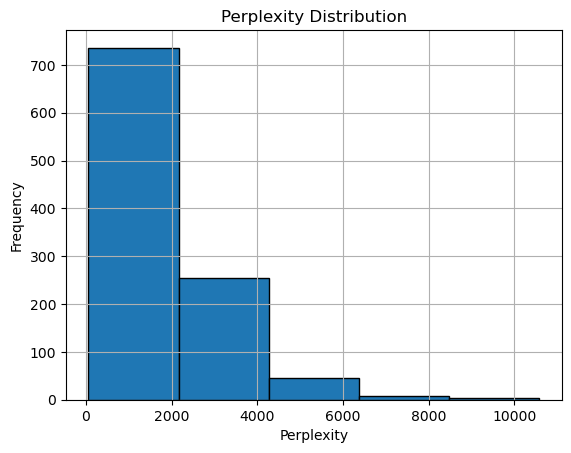

In [36]:
# Your code here
from scipy import stats

pp_list = [x for x in pp_list if x is not np.NaN]
mean = np.mean(pp_list)
median = np.median(pp_list)
mode = stats.mode(pp_list)
std_dev = np.std(pp_list)
print(f'mean is {mean}')
print(f'median is {median}')
print(f'mode is {mode}')
print(f'standard deviation is {std_dev}')

plt.hist(pp_list, bins=5, edgecolor='black')
plt.xlabel('Perplexity')
plt.ylabel('Frequency')
plt.title('Perplexity Distribution')
plt.grid(True)
plt.show()

## comments:
mode of perplexity distribution is about 56.0, which means that the most common perplexity is around 56.0. This means the model is decent and reliable for predicting a majority of the test set. Besides, the mean perplexity is about 1729.5 which is very high, this means the model will also be pretty struggling to predict for some sentences in the test set.

___
___


## **PART 2 [40 points] : Language Modelling using RNNs**
<br />    

In this part of the homework, you are to build and train a new language model. For this, we will be using Prof. Protopapas's famous texts, which end with `...` for prediction. Here, you will preprocess a data corpus and train your simple RNN network with it. With this network you will try to predict what he meant when he typed `...`. For this task, we will use a form of transfer learning: first training a network on the larger dataset, such as IMDB reviews, and then 'fine tuning' the network to the professor's texts.
<br /><br />
    
</div>

### **PART 2: Questions**
<br />

#### **2.1 [2 points] Preprocess the dataset**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>

<br />

**2.1.1** - Read in the dataset `imdb.csv`. Create a new dataframe by splitting each review into individual sentences. The sentences can be delimited by different characters such as period and question mark (eroteme). Call this column `text` in the new dataframe.
<br /><br />

**2.1.2** - Define a function `clean_data` that takes the new dataframe as input and removes all HTML tags and non-alphanumeric characters from the dataframe. Additionally, convert all characters to lowercase. Remove all the sentences where the number of words is less than 10 and higher than 30. Finally, add the start token `<s>` and the end token `</s>` to every sentence (row) in the dataframe. Return the processed the dataframe.

</details>

#### **2.2 [2 points] Tokenize the dataset**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**2.2.1** - Instantiate a Tokenizer for the dataset using `tensorflow.keras.preprocessing.text.Tokenizer` with a vocabulary size of 5000. Do **not** use an additional token for unknown, out-of-vocabulary words (OOV). That is, you will **not** have the equivalent of the `<UNK>` token.

*Hint:* Remove all filters from the function as we have already performed data cleaning. Set the value of the filter to be `''`.
<br /><br />

**2.2.2** - Fit the tokenizer on the dataset and get the sequence representation of each sentence, i.e use the fitted tokenizer to convert the words into their integer representation.
</details>

#### **2.3 [5 points] Modelling the data**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**2.3.1** - The first step is to split the dataset into the predictors ($X$) and the response ($Y$). The predictors for each observation (sentence) are all tokens in that sentence _except_ the **last** token. The response for a given sentence is all tokens in that sentence _except_ the **first**. Using `tf.keras.preprocessing.sequence.pad_sequences` post-pad each sequence in $X$ and $Y$ to a length of 30.
    
**Hint:** You may need to use `tf.convert_to_tensor` on the objects returned by the padding operation.
<br /><br />

```
Example:
if token for <s> = 1 and </s> = 2
sentence_i = [1, 48, 2498, 22, 16, 4, 4, 1554, 149, 14, 22, 2]
x_i = [1,  48,   2498, 22, 16, 4, 4,    1554, 149, 14, 22, 0, ..., 0]
y_i = [48, 2498, 22,   16, 4,  4, 1554, 149,  14,  22, 2,  0, ..., 0]
```


**2.3.2** - Define a simple RNN model that has an embedding layer with an embedding dimension of 300. You can define any number of RNN layers. The output of the RNN model will be a dense layer with the size of the vocabulary and softmax activation. Using the functional API here may make it easier to reuse parts of the network later on.
<br /><br />

**2.3.3** - Train the model with the $X$ and $Y$ data formed in 2.3.1. Use a validation split of 0.2. The choice of number of epochs and batch size is left to you. Plot the training and validation loss from the training history.

</details>

#### **2.4 [5 points] Modelling using LSTM and GRU**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**2.4.1** - Define an LSTM model that has an embedding layer with an embedding dimension of 300. Define two LSTM layers with a hidden state of 300 and 512 units, respectively. The output of the LSTM model will be a dense layer with size of the vocabulary and softmax activation, similar to the simple RNN model. Using the functional API here may make it easier to reuse parts of the network later on.

Train the model with the $X$ and $Y$ data formed in 2.3.1. Use a validation split of 0.2. Use an appropriate batch size and number of epochs. Plot the training and validation loss from the training history.

**2.4.2** -Now Build and Train a GRU-based model, with the layers and number of units similar to the LSTM model, and plot the training and validation loss

**2.4.3** - Does using an LSTM model instead of RNN result in a better hidden state representation of a sentence (and why)?

Answer in less than 150 words.


</details>

#### **2.5 [15 points] Predicting the next word**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**2.5.1** -Read the dataset `pp_text.csv`. Remove the last word from each sentence.
<br /><br />

**2.5.2** - Build a function `process_text` that takes in as argument a text sentence, does the required preprocessing and tokenization, removes the last token, and returns the tokenized sequence. You can use `tf.convert_to_tensor` to return a tensor object.

NOTE: Make sure you add the start token as a part of preprocessing the text in the function `process_text`
<br /><br />

**2.5.3** - Build a function `predict_next_word`, which takes a model and sentence as input arguments. Use `process_text` on the input sentence to process and tokenize it and predict the next word with the tokenized sentence as the input.

NOTE: You might have to expand the tensor returned by `process_text` along the last dimension.
<br /><br />

**2.5.4** - Choose five sentences from Pavlos' texts and use the `predict_next_word` function to predict the next word for each sentence. Do this for both the simple RNN and the trained LSTM model.
<br /><br />

**2.5.5** - We did not pad the input sentence in section 2.5.3. If RNNs can handle different sequence lengths, why is padding needed?

Answer in less than 100 words.
<br /><br />

**2.5.6** - Do you notice any pattern in the predicted words? Do they seem appropriate to the context? What do you attribute this discrepancy to? How can you resolve it?

Answer in less than 150 words.
<br></br>

**2.5.7** - Define a new model for predicting the next word using the previously trained RNN model. Instead of using a function, this model will be used to predict the next word for any 5 random sentences from Pavlos' texts.

NOTE: Based on your implementation, the output of the RNN model might have to be different from that of your trained network. You can make use of Keras functional API for this. The final goal is to obtain the prediction for the last time step only.
<br></br>

</details>

#### **2.6 [6 points] Training and Predicting with a different dataset**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


**2.6.1** - Read the dataset `cleaned_sarcasm.csv`. This dataset has been preprocessed. Tokenize, convert to sequence, and pad it, similar to 2.2.1, 2.2.2, and 2.3.1.
<br /><br />

**2.6.2** - Define and train an LSTM model (with the same architecture as given in 2.4.1) on the new dataset. Plot the training and validation traces to visualize the model's performance.
<br /><br />

**2.6.3** - Make predictions for the `pp_text.csv` dataset as you did in 2.5.4. Make sure you use the tokenizer defined in 2.6.1
<br /><br />

**2.6.4** - Using the perplexity function defined in Part 1 - 1.5.1.2, compute the perplexity for the LSTM model trained on `imdb` dataset and the LSTM model trained on `cleaned_sarcasm` dataset. Compare your results.
<br /><br />

**2.6.5** - What can go wrong if we use the same tokenizer from section 2.2.2 for tokenizing the dataset `cleaned_sarcasm.csv`?

Answer in less than 50 words.
<br /><br />
</details>
    
#### **2.7 [5 points] Completing the sentence**

<details>
<summary>
<font size="3" color="green">
<b>Click for Instructions</b>
</font>
</summary>


Until now, we have predicted a single word for a given sentence. However, what if Pavlos meant more than one word when he typed in `...`

We will now predict multiple words for each input sentence. To do this, first, predict one word, append this word to the input text and then predict one more with the updated input. Continue doing this for five words or until the end token `</s>`, or if the same word is predicted twice in a row (whichever comes first).

Write a function `complete_sentence`, which performs the function defined above.

Use this function and the LSTM network trained on the sarcasm dataset to predict the next words in any of the five sentences from `pp_text.csv`.
<br /><br />

</details>

---

### **PART 2: Solutions**

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **2.1 [2 points] Preprocess the dataset**

**2.1.1** - Read in the dataset `imdb.csv`. Create a new dataframe by splitting each review into individual sentences. The sentences can be delimited by different characters such as period and question mark (eroteme). Call this column `text` in the new dataframe.

</div>

In [37]:
# Read the data
file_path = "https://drive.google.com/uc?id=1gF1NzqlkV8sR_XtJ5LEQONchofOTuICu&export=download"
data = pd.read_csv(file_path, encoding='latin1')
data.head()

,text,polarity
0,"first think another Disney movie, might good, ...",1
1,"Put aside Dr. House repeat missed, Desperate H...",0
2,"big fan Stephen King's work, film made even gr...",1
3,watched horrid thing TV. Needless say one movi...,0
4,truly enjoyed film. acting terrific plot. Jeff...,1


In [38]:
# Your code here
df = data.copy()[['text']]
print(type(df))
df['text'] = df['text'].str.split(r'[.!?]')
df = df.explode('text').reset_index(drop=True)

<class 'pandas.core.frame.DataFrame'>


In [39]:
df.head()

,text
0,"first think another Disney movie, might good, ..."
1,"watch it, can't help enjoy it"
2,ages love movie
3,first saw movie 10 8 years later still love it
4,Danny Glover superb could play part better


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.1.2** - Define a function `clean_data` that takes the new dataframe as input and removes all HTML tags and non-alphanumeric characters from the dataframe. Additionally, convert all characters to lowercase. Remove all the sentences where the number of words is less than 10 and higher than 30. Finally, add the start token `<s>` and the end token `</s>` to every sentence (row) in the dataframe. Return the processed the dataframe.
    
</div>

In [40]:
# Your code here

In [41]:
# Defining clean_data function

def clean_data(df):
    # Your code here
    processed_df = df.copy()
    processed_df['text'] = processed_df['text'].apply(lambda x: re.sub(r'<[^>]+>|[^a-zA-Z0-9\s]', '', x))
    processed_df['text'] = processed_df['text'].str.lower()
    indices = [len(x.split())>=10 and len(x.split())<=30 for x in processed_df['text']]
    processed_df = processed_df.loc[indices]
    processed_df['text'] = processed_df['text'].apply(lambda x: '<s> ' + x + ' </s>')


    return processed_df.reset_index(drop=True)                                                                            # Returning the processed the dataframe

In [42]:
# Applying the clean_data function on the dataframe

clean_df = clean_data(df)
clean_df.head()

,text
0,<s> first think another disney movie might goo...
1,<s> first saw movie 10 8 years later still lo...
2,<s> never thought id say this want 15 minutes...
3,<s> recognized stable actors the usual suspec...
4,<s> my favorite parts office girl makes 029 ke...


In [43]:
clean_df.head()

,text
0,<s> first think another disney movie might goo...
1,<s> first saw movie 10 8 years later still lo...
2,<s> never thought id say this want 15 minutes...
3,<s> recognized stable actors the usual suspec...
4,<s> my favorite parts office girl makes 029 ke...


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">
    
#### **2.2 [2 points] Tokenize the dataset**
<br />

**2.2.1** - Instantiate a Tokenizer for the dataset using `tensorflow.keras.preprocessing.text.Tokenizer` with a vocabulary size of 5000. Do **not** use an additional token for unknown, out-of-vocabulary words (OOV). That is, you will **not** have the equivalent of the `<UNK>` token.

*Hint:* Remove all filters from the function as we have already performed data cleaning. Set the value of the filter to be `''`.
</div>

In [44]:
# Defining the tokenizer based on the above instructions

tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words = 5000, filters='')

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.2.2** - Fit the tokenizer on the dataset and get the sequence representation of each sentence, i.e use the fitted tokenizer to convert the words into their integer representation.  
</div>

In [45]:
# Your code here
tokenizer.fit_on_texts(clean_df['text'])
clean_df['text'] = tokenizer.texts_to_sequences(clean_df['text'])
clean_df.head()

,text
0,"[1, 20, 36, 69, 853, 4, 115, 9, 7, 260, 4, 2]"
1,"[1, 20, 146, 4, 348, 1322, 54, 162, 48, 44, 16..."
2,"[1, 40, 129, 408, 61, 67, 93, 1270, 135, 1696,..."
3,"[1, 3879, 74, 8, 570, 2366, 129, 688, 1415, 20..."
4,"[1, 1004, 547, 440, 908, 141, 64, 1287, 4391, 2]"


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">
    
#### **2.3 [5 points] Modelling the data**
<br />

**2.3.1** - The first step is to split the dataset into the predictors ($X$) and the response ($Y$). The predictors for each observation (sentence) are all tokens in that sentence _except_ the **last** token. The response for a given sentence is all tokens in that sentence _except_ the **first**. Using `tf.keras.preprocessing.sequence.pad_sequences` post-pad each sequence in $X$ and $Y$ to a length of 30.
    
**Hint:** You may need to use `tf.convert_to_tensor` on the objects returned by the padding operation.

```
Example:
if token for <s> = 1 and </s> = 2
sentence_i = [1, 48, 2498, 22, 16, 4, 4, 1554, 149, 14, 22, 2]
x_i = [1,  48,   2498, 22, 16, 4, 4,    1554, 149, 14, 22, 0, ..., 0]
y_i = [48, 2498, 22,   16, 4,  4, 1554, 149,  14,  22, 2,  0, ..., 0]
```

</div>    

In [46]:
# Your code here
#The first step is to split the dataset into the predictors ($X$) and the response ($Y$). The predictors for each observation (sentence) are all tokens in that sentence _except_ the **last** token. The response for a given sentence is all tokens in that sentence _except_ the **first**
# get predictor X:
X = clean_df['text'].apply(lambda x: x[:-1])
# get response Y:
Y = clean_df['text'].apply(lambda x: x[1:])

#Using `tf.keras.preprocessing.sequence.pad_sequences` post-pad each sequence in $X$ and $Y$ to a length of 30
# post-pad each sequence in X and Y to a length of 30:
X = tf.keras.preprocessing.sequence.pad_sequences(X, maxlen=30, padding='post')
Y = tf.keras.preprocessing.sequence.pad_sequences(Y, maxlen=30, padding='post')
# convert X and Y to tensor:
X = tf.convert_to_tensor(X)
Y = tf.convert_to_tensor(Y)

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">


**2.3.2** - Define a simple RNN model that has an embedding layer with an embedding dimension of 300. You can define any number of RNN layers. The output of the RNN model will be a dense layer with the size of the vocabulary and softmax activation. Using the functional API here may make it easier to reuse parts of the network later on.
<br /><br />
</div>

In [47]:
#Define a simple RNN model that has an embedding layer with an embedding dimension of 300
# Your code here
vocab_size = 5000
# define the model:
model_RNN = tf.keras.Sequential()
model_RNN.add(layers.Embedding(input_dim=vocab_size, output_dim=300, mask_zero=True))
# 2 layers of SimpleRNN:
model_RNN.add(layers.SimpleRNN(300, return_sequences=True))
model_RNN.add(layers.SimpleRNN(300, return_sequences=True))
# a dense layer with the size of the vocabulary and softmax activation:
model_RNN.add(layers.Dense(vocab_size, activation='softmax'))

In [91]:
print(vocab_size)

54319


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.3.3** - Train the model with the $X$ and $Y$ data formed in 2.3.1. Use a validation split of 0.2. The choice of number of epochs and batch size is left to you. Plot the training and validation loss from the training history.
<br /><br />
    
</div>

In [49]:
# Your code here
model_RNN.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
history_RNN = model_RNN.fit(X, Y, epochs=10, batch_size=128, validation_split=0.2)

Epoch 1/10
345/345 [==============================] - 51s 143ms/step - loss: 3.1984 - accuracy: 0.0814 - val_loss: 3.1418 - val_accuracy: 0.0851
Epoch 2/10
345/345 [==============================] - 49s 142ms/step - loss: 3.1141 - accuracy: 0.0858 - val_loss: 3.1352 - val_accuracy: 0.0851
Epoch 3/10
345/345 [==============================] - 47s 137ms/step - loss: 3.1038 - accuracy: 0.0860 - val_loss: 3.1282 - val_accuracy: 0.0854
Epoch 4/10
345/345 [==============================] - 48s 138ms/step - loss: 3.0871 - accuracy: 0.0867 - val_loss: 3.1090 - val_accuracy: 0.0859
Epoch 5/10
345/345 [==============================] - 47s 137ms/step - loss: 3.0647 - accuracy: 0.0879 - val_loss: 3.0939 - val_accuracy: 0.0867
Epoch 6/10
345/345 [==============================] - 48s 138ms/step - loss: 3.0448 - accuracy: 0.0891 - val_loss: 3.0774 - val_accuracy: 0.0866
Epoch 7/10
345/345 [==============================] - 49s 143ms/step - loss: 3.0222 - accuracy: 0.0903 - val_loss: 3.0593 - val_ac

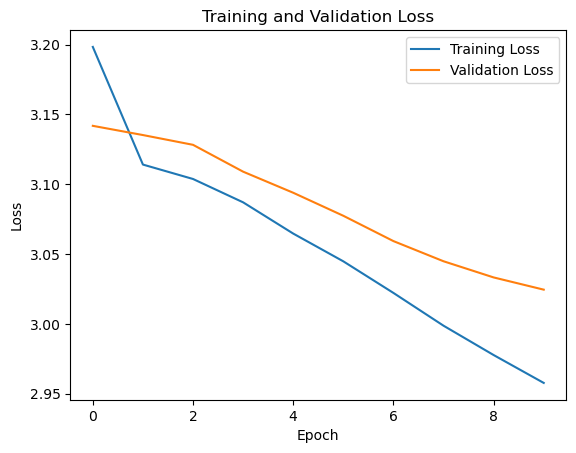

In [50]:
# Your code here
# plot the training and validation loss from the history object
# plot the training and validation loss:
plt.plot(history_RNN.history['loss'], label='Training Loss')
plt.plot(history_RNN.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **2.4 [5 points] Modelling using LSTM and GRU**
<br /><br />
**2.4.1** - Define an LSTM model that has an embedding layer with an embedding dimension of 300. Define two LSTM layers with a hidden state of 300 and 512 units, respectively. The output of the LSTM model will be a dense layer with size of the vocabulary and softmax activation, similar to the simple RNN model. Using the functional API here may make it easier to reuse parts of the network later on.

Train the model with the $X$ and $Y$ data formed in 2.3.1. Use a validation split of 0.2. Use an appropriate batch size and number of epochs. Plot the training and validation loss from the training history.
<br /><br />
    
</div>

In [51]:
# Your code here
# Define an LSTM model that has an embedding layer with an embedding dimension of 300. Define two LSTM layers with a hidden state of 300 and 512 units, respectively.
# define the model:
model_lstm = tf.keras.Sequential()
model_lstm.add(layers.Embedding(input_dim=vocab_size, output_dim=300, mask_zero=True))
# 2 layers of LSTM:
model_lstm.add(layers.LSTM(300, return_sequences=True))
model_lstm.add(layers.LSTM(512, return_sequences=True))
# a dense layer with the size of the vocabulary and softmax activation:
model_lstm.add(layers.Dense(vocab_size, activation='softmax'))

In [52]:
# Your code here
model_lstm.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
history_lstm = model_lstm.fit(X, Y, epochs=10, batch_size=128, validation_split=0.2)

Epoch 1/10


345/345 [==============================] - 55s 142ms/step - loss: 3.2747 - accuracy: 0.0775 - val_loss: 3.1958 - val_accuracy: 0.0772
Epoch 2/10
345/345 [==============================] - 47s 138ms/step - loss: 3.1581 - accuracy: 0.0798 - val_loss: 3.1681 - val_accuracy: 0.0815
Epoch 3/10
345/345 [==============================] - 48s 138ms/step - loss: 3.1390 - accuracy: 0.0846 - val_loss: 3.1564 - val_accuracy: 0.0848
Epoch 4/10
345/345 [==============================] - 48s 138ms/step - loss: 3.1259 - accuracy: 0.0858 - val_loss: 3.1446 - val_accuracy: 0.0849
Epoch 5/10
345/345 [==============================] - 48s 138ms/step - loss: 3.1105 - accuracy: 0.0860 - val_loss: 3.1260 - val_accuracy: 0.0854
Epoch 6/10
345/345 [==============================] - 48s 138ms/step - loss: 3.0976 - accuracy: 0.0863 - val_loss: 3.1187 - val_accuracy: 0.0853
Epoch 7/10
345/345 [==============================] - 48s 138ms/step - loss: 3.0859 - accuracy: 0.0863 - val_loss: 3.1070 - val_accuracy: 0.0

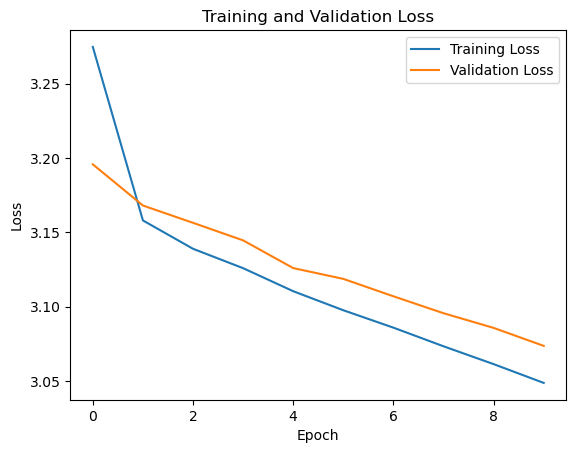

In [53]:
# plot the training and validation loss from the history object
# plot the training and validation loss:
plt.plot(history_lstm.history['loss'], label='Training Loss')
plt.plot(history_lstm.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.4.2** -Now Build and Train a GRU-based model, with the layers and number of units similar to the LSTM model, and plot the training and validation loss.
</div>

In [54]:
# Your code here
# GRU similiar to LSTM
model_gru = tf.keras.Sequential()
model_gru.add(layers.Embedding(input_dim=vocab_size, output_dim=300, mask_zero=True))
# 2 layers of GRU:
model_gru.add(layers.GRU(300, return_sequences=True))
model_gru.add(layers.GRU(512, return_sequences=True))
# a dense layer with the size of the vocabulary and softmax activation:
model_gru.add(layers.Dense(vocab_size, activation='softmax'))

In [55]:
# Your code here
model_gru.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
history_gru = model_gru.fit(X, Y, epochs=10, batch_size=128, validation_split=0.2)

Epoch 1/10


345/345 [==============================] - 53s 142ms/step - loss: 3.2408 - accuracy: 0.0790 - val_loss: 3.1531 - val_accuracy: 0.0840
Epoch 2/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1280 - accuracy: 0.0853 - val_loss: 3.1460 - val_accuracy: 0.0850
Epoch 3/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1221 - accuracy: 0.0855 - val_loss: 3.1447 - val_accuracy: 0.0849
Epoch 4/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1177 - accuracy: 0.0857 - val_loss: 3.1407 - val_accuracy: 0.0848
Epoch 5/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1146 - accuracy: 0.0858 - val_loss: 3.1392 - val_accuracy: 0.0852
Epoch 6/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1111 - accuracy: 0.0860 - val_loss: 3.1364 - val_accuracy: 0.0851
Epoch 7/10
345/345 [==============================] - 48s 139ms/step - loss: 3.1078 - accuracy: 0.0859 - val_loss: 3.1375 - val_accuracy: 0.0

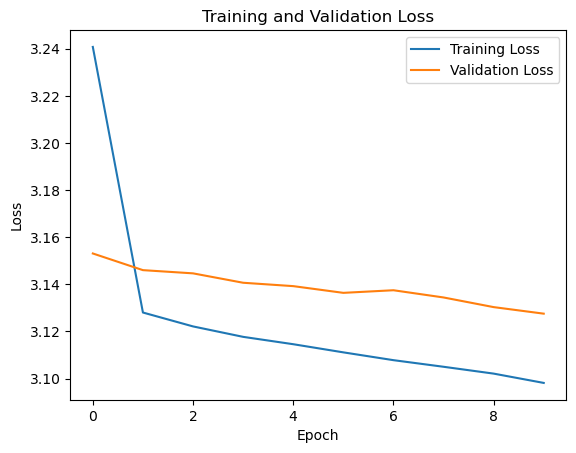

In [56]:
# plot the training and validation loss from the history object
# plot the training and validation loss:
plt.plot(history_gru.history['loss'], label='Training Loss')
plt.plot(history_gru.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.4.3** - Does using an LSTM model instead of RNN result in a better hidden state representation of a sentence (and why)?

Answer in less than 150 words.
</div>

Answer: LSTM results in a better hidden state representation of a sentence.
Compared to a standard RNN, an LSTM has an additional "memory cell" that can store information over a longer period of time. This allows the LSTM to capture longer-range dependencies in the input sequence, which can be beneficial for a better hidden state representation than a standard RNN.

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

#### **2.5 [15 points] Predicting the next word**
<br />

**2.5.1** -Read the dataset `pp_text.csv`. Remove the last word from each sentence.
</div>

In [57]:
# Read the data
file_path = "https://drive.google.com/uc?id=1sFolPhc31mqvCxC3JxORmur21e28XeA-&export=download"
df_pred = pd.read_csv(file_path)
df_pred.head()

,Text
0,When you make changes please always check if e...
1,I found them very similar
2,Give some overview of what the exercises are a...
3,Honestly I do not remember
4,Can you check the video


In [58]:
# Your code here
print(df_pred.Text[0])
df_pred.Text = df_pred.Text.apply(lambda x : ' '.join(x.split(' ')[:-1]))
print(df_pred.Text[0])

When you make changes please always check if everything is working
When you make changes please always check if everything is



<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.5.2** - Build a function `process_text` that takes in as argument a text sentence, does the required preprocessing and tokenization, removes the last token, and returns the tokenized sequence. You can use `tf.convert_to_tensor` to return a tensor object.

NOTE: Make sure you add the start token as a part of preprocessing the text in the function `process_text`

In [64]:
str1 = ["i love you guys", "i love you guys so much", "i love you guys so much and i love you guys so much"]
str2 = "i love you"
tk1 = tokenizer.texts_to_sequences(str1)
tk2 = tokenizer.texts_to_sequences([str2])

print(tk1)
print(tk2)
print(tf.convert_to_tensor(tk2))

[[56, 44, 286, 378], [56, 44, 286, 378, 365, 17], [56, 44, 286, 378, 365, 17, 84, 56, 44, 286, 378, 365, 17]]
[[56, 44, 286]]
tf.Tensor([[ 56  44 286]], shape=(1, 3), dtype=int32)


In [61]:
def process_text(text:str):

    # Your code here
    text = '<s> ' + text.lower()
    # this tokenizer is from the above cells
    tokenized_text = tokenizer.texts_to_sequences([text])

    tokenized_text = [seq[:-1] for seq in tokenized_text]

    tokenized_text = tf.convert_to_tensor(tokenized_text)

    return  tokenized_text                                               # Returning the processed sequence


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">


**2.5.3** - Build a function `predict_next_word`, which takes a model and sentence as input arguments. Use `process_text` on the input sentence to process and tokenize it and predict the next word with the tokenized sentence as the input.

NOTE: You might have to expand the tensor returned by `process_text` along the last dimension.
</div>


In [76]:
def predict_next_word(model, sentence:str):

    tokenized_sentence = process_text(sentence)

    #expand the tensor along the last dimension
    tokenized_sentence = tf.expand_dims(tokenized_sentence,axis=-1)

    predictions = model.predict(tokenized_sentence)
    #print(predictions.shape)
    # since we are using soft max, we need to find the index that have the most probability:
    predictions_index = tf.argmax(predictions, axis=-1).numpy()[0]
    #predictions_index = [x - 1 for x in predictions_index]
    #print(predictions_index)
    predicted_word = np.array(list(tokenizer.word_index.keys()))[predictions_index]

    return predicted_word

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.5.4** - Choose five sentences from Pavlos' texts and use the `predict_next_word` function to predict the next word for each sentence. Do this for both the simple RNN and the trained LSTM model.
</div>

In [77]:
# Your code here
#Choose five sentences from Pavlos' texts and use the `predict_next_word` function to predict the next word for each sentence. Do this for both the simple RNN and the trained LSTM model

# Your code here
for i in range(5):
  print(f'True: {df_pred.Text[i]}')
  print(f'The RNN prediction is: {predict_next_word(model_RNN, df_pred.Text[i])}')
  print(f'The LSTM prediction is: {predict_next_word(model_lstm, df_pred.Text[i])}')
  print(f'---------------------------')
    

True: When you make changes please always check if everything is
1/1 [==============================] - 0s 13ms/step


(1, 10, 54319)
[ 8  3  3  3  3  6  6 53  2  2]
The RNN prediction is: ['good' 'movie' 'movie' 'movie' 'movie' 'its' 'its' 'years' 'film' 'film']
1/1 [==============================] - 0s 12ms/step
(1, 10, 54319)
[8 3 6 4 4 6 4 2 2 2]
The LSTM prediction is: ['good' 'movie' 'its' 'one' 'one' 'its' 'one' 'film' 'film' 'film']
---------------------------
True: I found them very
1/1 [==============================] - 0s 13ms/step
(1, 4, 54319)
[ 8 36  3  3]
The RNN prediction is: ['good' 'life' 'movie' 'movie']
1/1 [==============================] - 0s 14ms/step
(1, 4, 54319)
[8 4 4 6]
The LSTM prediction is: ['good' 'one' 'one' 'its']
---------------------------
True: Give some overview of what the exercises are and why they are
1/1 [==============================] - 0s 14ms/step
(1, 10, 54319)
[ 8 12  3  3  3  3  3  5  2  2]
The RNN prediction is: ['good' 'story' 'movie' 'movie' 'movie' 'movie' 'movie' 'like' 'film'
 'film']
1/1 [==============================] - 0s 13ms/step
(1, 10, 543

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.5.5** - We did not pad the input sentence in section 2.5.3. If RNNs can handle different sequence lengths, why is padding needed?

Answer in less than 100 words.
</div>

Answer: Padding is used to ensure that all input sequences have the same length, which is necessary for efficient computation using batch processing. While RNNs can handle sequences of different lengths, training a model on sequences of different lengths can be inefficient due to the way batches are typically processed.
Padding ensures that the inputs in each batch have the same shape, which allows them to be processed in parallel. Without padding, the sequences in each batch would have different lengths, which would require additional computation to handle the variable lengths.
Additionally, padding can help to ensure that the model learns to focus on the relevant information in the input sequence, rather than being distracted by the varying lengths of the sequences.

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.5.6** - Do you notice any pattern in the predicted words? Do they seem appropriate to the context? What do you attribute this discrepancy to? How can you resolve it?

Answer in less than 150 words.
</div>


Answer: I noticed that many of the predictions are related to movies and films or some general comment words like "good", which is not appropriate for the context we are talking about. This is likely because both the RNN and LSTM models were trained on the IMDB movie review dataset. Additionally, training the models for only 10 epochs resulted in relatively low accuracy(less than 0.1), causing the model's predictions to lean towards movie-related words. To resolve this problem, we can either change the training dataset or train the model for a few more epochs to improve its accuracy.



<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">


**2.5.7** - Define a new model for predicting the next word using the previously trained RNN model. Instead of using a function, this model will be used to predict the next word for any 5 random sentences from Pavlos' texts.

NOTE: Based on your implementation, the output of the RNN model might have to be different from that of your trained network. You can make use of Keras functional API for this. The final goal is to obtain the prediction for the last time step only.
</div>


In [107]:
X = clean_df.text.apply(lambda x: x[:-1])
Y = clean_df.text.apply(lambda x: x[-1])
X = tf.keras.preprocessing.sequence.pad_sequences(X, maxlen=30, padding='post')
# Y = tf.keras.preprocessing.sequence.pad_sequences(Y, maxlen=30, padding='post')
X = tf.convert_to_tensor(X)
Y = tf.convert_to_tensor(Y)

In [108]:
# Your code here
# Define a new model for predicting the next word using the previously trained RNN model. Instead of using a function, this model will be used to predict the next word for any 5 random sentences from Pavlos' text
# define a new model:
model_new = tf.keras.Sequential()
model_new.add(layers.Embedding(input_dim=5000, output_dim=300, mask_zero=True))
# 2 layers of SimpleRNN:
model_new.add(layers.SimpleRNN(300, return_sequences=True))
model_new.add(layers.SimpleRNN(300))
# a dense layer with the size of the vocabulary and softmax activation:
model_new.add(layers.Dense(5000, activation='softmax'))
# compile the model:
model_new.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# fit the model:
history_new = model_new.fit(X, Y, epochs=10, batch_size=128, validation_split=0.2)


Epoch 1/10
345/345 [==============================] - 36s 103ms/step - loss: 0.1625 - accuracy: 0.9949 - val_loss: 3.6204e-04 - val_accuracy: 1.0000
Epoch 2/10
345/345 [==============================] - 35s 103ms/step - loss: 2.6764e-04 - accuracy: 1.0000 - val_loss: 1.9298e-04 - val_accuracy: 1.0000
Epoch 3/10
345/345 [==============================] - 35s 100ms/step - loss: 1.5088e-04 - accuracy: 1.0000 - val_loss: 1.1776e-04 - val_accuracy: 1.0000
Epoch 4/10
345/345 [==============================] - 35s 103ms/step - loss: 9.6056e-05 - accuracy: 1.0000 - val_loss: 7.8127e-05 - val_accuracy: 1.0000
Epoch 5/10
345/345 [==============================] - 35s 101ms/step - loss: 6.5641e-05 - accuracy: 1.0000 - val_loss: 5.5024e-05 - val_accuracy: 1.0000
Epoch 6/10
345/345 [==============================] - 34s 97ms/step - loss: 4.7133e-05 - accuracy: 1.0000 - val_loss: 4.0215e-05 - val_accuracy: 1.0000
Epoch 7/10
345/345 [==============================] - 35s 101ms/step - loss: 3.4997e-05

In [111]:
# predict the next word for 5 random sentences from Pavlos' text:
for i in range(5):
    print(f'True: {df_pred.Text[i]}')
    print(f'The new model prediction is: {predict_next_word(model_new, df_pred.Text[i])}')
    print(f'---------------------------')

True: When you make changes please always check if everything is
1/1 [==============================] - 0s 13ms/step


(1, 5000)
2
The new model prediction is: a
---------------------------
True: I found them very
1/1 [==============================] - 0s 13ms/step
(1, 5000)
2
The new model prediction is: a
---------------------------
True: Give some overview of what the exercises are and why they are
1/1 [==============================] - 0s 13ms/step
(1, 5000)
2
The new model prediction is: a
---------------------------
True: Honestly I do not
1/1 [==============================] - 0s 12ms/step
(1, 5000)
2
The new model prediction is: a
---------------------------
True: Can you check the
1/1 [==============================] - 0s 12ms/step
(1, 5000)
2
The new model prediction is: a
---------------------------


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">


#### **2.6 [6 points] Training and Predicting with a different dataset**
<br />


**2.6.1** - Read the dataset `cleaned_sarcasm.csv`. This dataset has been preprocessed. Tokenize, convert to sequence, and pad it, similar to 2.2.1, 2.2.2, and 2.3.1.  
</div>

In [88]:
# Read the data
file_path = "https://drive.google.com/uc?id=1kHZIXEcf_t0t2GcxtafF3mL0kuoC4etf&export=download"
df = pd.read_csv(file_path)
df.head()

,text
0,you do know west teams play against west teams...
1,they were underdogs earlier today but since gr...
2,you dont have to you have a good build buy gam...
3,i think a significant amount would be against ...
4,ayy bb wassup it makes a bit more sense in con...


In [89]:
# Your code here
# Tokenize, convert to sequence, and pad it, similar to 2.2.1, 2.2.2, and 2.3.1
# define the tokenizer:
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words = 5000,filters='')
tokenizer.fit_on_texts(df['text'])
df['text'] = tokenizer.texts_to_sequences(df['text'])

# get predictor X:
X = df['text'].apply(lambda x: x[:-1])
# get response Y:
Y = df['text'].apply(lambda x: x[1:])

#Using `tf.keras.preprocessing.sequence.pad_sequences` post-pad each sequence in $X$ and $Y$ to a length of 30
# post-pad each sequence in X and Y to a length of 30:
X = tf.keras.preprocessing.sequence.pad_sequences(X, maxlen=30, padding='post')
Y = tf.keras.preprocessing.sequence.pad_sequences(Y, maxlen=30, padding='post')
# convert X and Y to tensor:
X = tf.convert_to_tensor(X)
Y = tf.convert_to_tensor(Y)

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.6.2** - Define and train an LSTM model (with the same architecture as given in 2.4.1) on the new dataset. Plot the training and validation traces to visualize the model's performance.
</div>

In [90]:
# Your code here
# efine and train an LSTM model (with the same architecture as given in 2.4.1) on the new dataset. Plot the training and validation traces to visualize the model's performance
# define the model:
model_lstm1 = tf.keras.Sequential()
model_lstm1.add(layers.Embedding(input_dim=5000, output_dim=300, mask_zero=True))
# 2 layers of LSTM:
model_lstm1.add(layers.LSTM(300, return_sequences=True))
model_lstm1.add(layers.LSTM(512, return_sequences=True))
# a dense layer with the size of the vocabulary and softmax activation:
model_lstm1.add(layers.Dense(5000, activation='softmax'))
# compile the model:
model_lstm1.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# train the model:
history_lstm1 = model_lstm1.fit(X, Y, epochs=10, batch_size=128, validation_split=0.2)


Epoch 1/10
1810/1810 [==============================] - 52s 27ms/step - loss: 2.5323 - accuracy: 0.1044 - val_loss: 2.5201 - val_accuracy: 0.1297
Epoch 2/10
1810/1810 [==============================] - 47s 26ms/step - loss: 2.2958 - accuracy: 0.1475 - val_loss: 2.4184 - val_accuracy: 0.1487
Epoch 3/10
1810/1810 [==============================] - 48s 27ms/step - loss: 2.2117 - accuracy: 0.1624 - val_loss: 2.3679 - val_accuracy: 0.1578
Epoch 4/10
1810/1810 [==============================] - 49s 27ms/step - loss: 2.1554 - accuracy: 0.1717 - val_loss: 2.3393 - val_accuracy: 0.1642
Epoch 5/10
1810/1810 [==============================] - 46s 25ms/step - loss: 2.1122 - accuracy: 0.1788 - val_loss: 2.3228 - val_accuracy: 0.1679
Epoch 6/10
1810/1810 [==============================] - 47s 26ms/step - loss: 2.0761 - accuracy: 0.1847 - val_loss: 2.3130 - val_accuracy: 0.1705
Epoch 7/10
1810/1810 [==============================] - 47s 26ms/step - loss: 2.0449 - accuracy: 0.1899 - val_loss: 2.3072 -

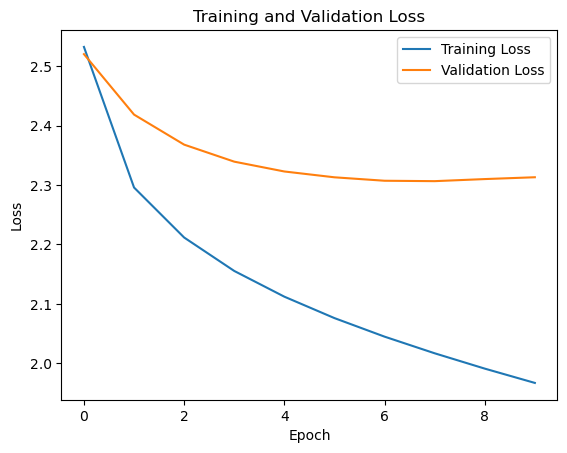

In [92]:
# plot the training and validation loss from the history object
# plot the training and validation loss:
plt.plot(history_lstm1.history['loss'], label='Training Loss')
plt.plot(history_lstm1.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.6.3** - Make predictions for the `pp_text.csv` dataset as you did in 2.5.4. Make sure you use the tokenizer defined in 2.6.1
</div>



In [109]:
# Your code here
for i in range(5):
  print(f'True: {df_pred.Text[i]}')
  print(f'The LSTM prediction is: {predict_next_word(model_lstm1, df_pred.Text[i])}')
  print(f'---------------------------')
    

True: When you make changes please always check if everything is
1/1 [==============================] - 1s 1s/step
(1, 9, 5000)
[ 7 45  3  2 33 15 55  7  8]
The LSTM prediction is: ['is' 'about' 'i' 'a' 'at' 'have' 'has' 'is' 'it']
---------------------------
True: I found them very
1/1 [==============================] - 1s 1s/step
(1, 3, 5000)
[33  3 11]
The LSTM prediction is: ['at' 'i' 'for']
---------------------------
True: Give some overview of what the exercises are and why they are
1/1 [==============================] - 0s 20ms/step
(1, 9, 5000)
[  9  53   1   1 409 188   8  18  23]
The LSTM prediction is: ['that' 'think' 'to' 'to' 'lost' 'least' 'it' 'if' 'its']
---------------------------
True: Honestly I do not
1/1 [==============================] - 0s 19ms/step
(1, 2, 5000)
[33 18]
The LSTM prediction is: ['at' 'if']
---------------------------
True: Can you check the
1/1 [==============================] - 0s 18ms/step
(1, 3, 5000)
[ 39 803  55]
The LSTM prediction is: ['im


<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">

**2.6.4** - Using the perplexity function defined in Part 1 - 1.5.1.2, compute the perplexity for the LSTM model trained on `imdb` dataset and the LSTM model trained on `cleaned_sarcasm` dataset. Compare your results.
</div>

In [95]:
# Your code here
# compute the perplexity for model_lstm and model_lstm1:
# compute the perplexity for model_lstm on validation set:
loss_lstm = 0
for loss in history_lstm.history['val_loss']:
    loss_lstm += loss
loss_lstm = loss_lstm / len(history_lstm.history['val_loss'])
perplexity_lstm = np.exp(loss_lstm)
print("perplexity for model_lstm(imdb) on validation set:", perplexity_lstm)
# compute the perplexity for model_lstm1 on validation set:
loss_lstm1 = 0
for loss in history_lstm1.history['val_loss']:
    loss_lstm1 += loss
loss_lstm1 = loss_lstm1 / len(history_lstm1.history['val_loss'])
perplexity_lstm1 = np.exp(loss_lstm1)
print("perplexity for model_lstm1(cleaned_sarcasm) on validation set:", perplexity_lstm1)


perplexity for model_lstm(imdb) on validation set: 22.80970238002494
perplexity for model_lstm1(cleaned_sarcasm) on validation set: 10.504621666762057


## compare the results
Answer: the lstm model trained on cleaned_sarcasm data has a lower value of perplexity. This means this model are better for predicting its validation set.


**2.6.5** - What can go wrong if we use the same tokenizer from section 2.2.2 for tokenizing the dataset `cleaned_sarcasm.csv`?

Answer in less than 50 words.

Answer: The tokenizer in 2.2.2 is trained on imdb.csv, which is based on the corpus of imdb moview reviews. If we use this tokenizer to tokenize the dataset cleaned_sarcasm.csv, there will be a lot of unknown words with high perplexity, and the prediction will be poorly performed.

<div class="alert alert-block alert-danger" style="color:black;background-color:#E7F4FA">


#### **2.7 [5 points] Completing the sentence**
<br />

Until now, we have predicted a single word for a given sentence. However, what if he meant more than one word when he typed in `...`

We will now predict multiple words for each input sentence. To do this, first, predict one word, append this word to the input text and then predict one more with the updated input. Continue doing this for five words or until the end token `</s>`, or if the same word is predicted twice in a row(whichever comes first).

Write a function `complete_sentence`, which performs the function defined above.

Use this function and the LSTM network trained on the sarcasm dataset to predict the next words in any of the five sentences from `pp_text.csv`.


In [112]:
def complete_sentence(model, sentence:str)->str: # The input and the output sentence of the function is a string

    # Your code here
    # We will now predict multiple words for each input sentence. To do this, first, predict one word, append this word to the input text and then predict one more with the updated input. Continue doing this for five words or until the end token `</s>`, or if the same word is predicted twice in a row(whichever comes first)
    last_prediction = ''
    for i in range(5):
        predicted_word = predict_next_word(model, sentence)[-1]
        if predicted_word == last_prediction:
            break
        last_prediction = predicted_word
        sentence = sentence + ' ' + predicted_word
        if predicted_word == '</s>':
            break
    return sentence

In [113]:
# Your code here
# use the complete_sentence function to complete the sentences:
for i in range(5):
    print(f'True: {df_pred.Text[i]}')
    print(f'The completed sentence is: {complete_sentence(model_lstm1, df_pred.Text[i])}')
    print(f'---------------------------')

True: When you make changes please always check if everything is
1/1 [==============================] - 0s 19ms/step
(1, 9, 5000)
[ 7 45  3  2 33 15 55  7  8]
1/1 [==============================] - 0s 20ms/step
(1, 10, 5000)
[  7  45   3   2  33  15  55   7   8 284]
1/1 [==============================] - 0s 21ms/step
(1, 11, 5000)
[  7  45   3   2  33  15  55   7   8 284   8]
1/1 [==============================] - 0s 22ms/step
(1, 12, 5000)
[  7  45   3   2  33  15  55   7   8 284   8  44]
1/1 [==============================] - 0s 20ms/step
(1, 13, 5000)
[  7  45   3   2  33  15  55   7   8 284   8  44   8]
The completed sentence is: When you make changes please always check if everything is it player it get it
---------------------------
True: I found them very
1/1 [==============================] - 0s 17ms/step
(1, 3, 5000)
[33  3 11]
1/1 [==============================] - 0s 19ms/step
(1, 4, 5000)
[33  3 11 62]
1/1 [==============================] - 0s 18ms/step
(1, 5, 5000)
[33  3 